In [1]:
import pandas as pd
import rasterio
import os
import numpy as np
from shapely.geometry import Polygon, box, mapping
import rioxarray

### Purpose of the notebook: 

- When plotting images that have been reprojected, there is always a small gap between two neighbouring tiles
- Question is, whether this is a problem inherent to the data of whether this occurs only because of the ordering of reprojecting to EPSG:4326 and the plotting
- To test this, I will read in and merge two neighbouring tiles and then reproject. If there is no gap, the gaps occur due to the ordering

In [2]:
import yaml
config_path = '/Users/maltegenschow/Documents/Uni/SoSe23/Data Science Project/DS_Project/modules/config.yml'
with open(config_path, 'r') as f:
    config = yaml.load(f, Loader=yaml.FullLoader)

In [3]:
tiles = [elem for elem in os.listdir(os.path.join(config['data']['orthophotos'], 'raw_tiles')) if elem .endswith('.tif')]
tiles = [os.path.join(config['data']['orthophotos'], 'raw_tiles', elem) for elem in tiles]
tiles

['/Users/maltegenschow/Documents/Uni/SoSe23/Data Science Project/data/orthophotos/raw_tiles/32689_5338.tif',
 '/Users/maltegenschow/Documents/Uni/SoSe23/Data Science Project/data/orthophotos/raw_tiles/32690_5337.tif',
 '/Users/maltegenschow/Documents/Uni/SoSe23/Data Science Project/data/orthophotos/raw_tiles/32689_5337.tif',
 '/Users/maltegenschow/Documents/Uni/SoSe23/Data Science Project/data/orthophotos/raw_tiles/32690_5338.tif']

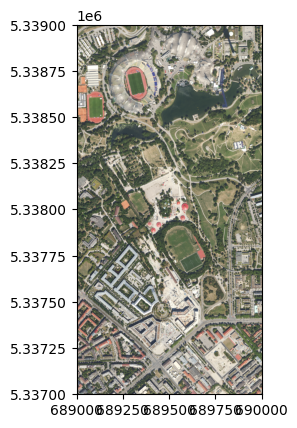

In [4]:
import rasterio
from rasterio.merge import merge
from rasterio.plot import show

# Open the two raster files
with rasterio.open(tiles[0]) as src1, rasterio.open(tiles[2]) as src2:
    # Merge the two datasets and get the transform and shape of the output file
    mosaic, out_trans = merge([src1, src2])

    # Update the transform in the output file to match the correct transform affine
    out_trans = src1.transform

    # Update the metadata in the output file to match the input files
    out_meta = src1.meta.copy()
    out_meta.update({
        "transform": out_trans,
        "height": mosaic.shape[1],
        "width": mosaic.shape[2]
    })

    # Write the merged file to disk
    with rasterio.open('test.tif', "w", **out_meta) as dest:
        dest.write(mosaic)

# Open the merged output file and display it
with rasterio.open('test.tif') as dst:
    show(dst)


In [5]:
dst = rioxarray.open_rasterio('test.tif')
dst = dst.rio.reproject('EPSG:4326')
image_bounds = box(*dst.rio.bounds())

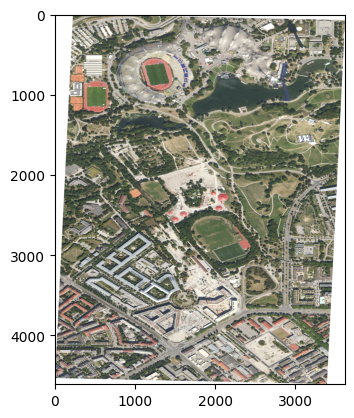

In [6]:
img = np.dstack((dst.values[0], dst.values[1], dst.values[2]))
import matplotlib.pyplot as plt
plt.imshow(img)
plt.show()

In [7]:
import folium
m = folium.Map(location=[image_bounds.centroid.y, image_bounds.centroid.x], zoom_start=14)
folium.GeoJson(image_bounds.__geo_interface__).add_to(m)
min_x, min_y, max_x, max_y = dst.rio.bounds()

corner_coordinates = [[min_y, min_x], [max_y, max_x]]
folium.raster_layers.ImageOverlay(
        img,
        bounds=corner_coordinates,
        opacity=0.95,
        interactive=True,
        cross_origin=False,
        zindex=1,
    ).add_to(m)

m